# Scratchwork

In [1]:
import sys
sys.path.append('../') # local path append

# for crs suppression
# import warnings
# warnings.filterwarnings("ignore", category=UserWarning)

import Utilities
import Input_FEDS
import Input_Reference
import Output_Calculation

from Input_FEDS import InputFEDS
from Input_Reference import InputReference
from Output_Calculation import OutputCalculation
from Utilities import *

In [2]:
# this is the ONLY section users are intended to modify!
# inputs for searching FEDS and nifc sets

# START TIME
year_start = 2019
month_start = 8 
day_start = 1
hour_start = 0
minute_start = 0
second_start = 0
tz_offset_hours_start = 0
tz_offset_minutes_start = 0
utc_offset_start = '00:00'

# END TIME
year_stop = 2019
month_stop = 9
day_stop = 30
hour_stop = 23
minute_stop = 0
second_stop = 0
tz_offset_hours_stop = 0
tz_offset_minutes_stop = 0
utc_offset_stop = '00:00'

# CRS - 4326 RECOMMENDED FEDS FIRE PERIM DEFAULT
crs = 3857 # 4326

# BBOX FOR SEARCH - [lon, lat, lon, lat]
search_bbox = ["-125.0", "24.396308", "-66.93457", "49.384358"] 

# DAY SEARCH RANGE- acceptable distance warning to search from feds -> reference (e.g. if reference polygon is 8 days away, output a warning)
# note by default, any results not of the same year are eliminated
day_search_range = 7 

# FEDS INPUT SETTINGS
feds_title = "firenrt"
feds_collection =  "public.eis_fire_lf_perimeter_archive"
feds_access_type = "api"
feds_limit = 9000 # amount of features to consider for FEDS API access; warning appears if it misses any entries
feds_filter = False
feds_apply_finalfire = True

# REFERENCE INPUT SETTINGS 
ref_title ="Historic_GeoMAC_Perimeters_2019"
ref_control_type = "defined" # or "custom"
ref_custom_url = "none"
ref_custom_read_type = "none"
ref_filter = False # False or a valid query

# OUTPUT SETTINGS - User discretion advised for path functionality
print_on = True
plot_on = True
name_for_output_file = "40_FUEL_MASSIVE_RUN"
output_format = "csv"
user_path = "/projects/my-public-bucket/VEDA-PEC/results"
output_maap_url = f"{user_path}/{name_for_output_file}.{output_format}"

### Argument Processing: format and check to report any issues
- Note: upon instance instantiation we can also get reports back of invalidity -> any warnings/errors should be addressed

In [3]:

# start date formatting
search_start = Utilities.format_datetime(year_start, 
                                         month_start, 
                                         day_start, 
                                         hour_start, 
                                         minute_start, 
                                         second_start, 
                                         tz_offset_hours_start, 
                                         tz_offset_minutes_start,
                                         utc_offset_start)
# stop date formatting
search_stop = Utilities.format_datetime(year_stop, 
                                        month_stop, 
                                        day_stop, 
                                        hour_stop, 
                                        minute_stop, 
                                        second_stop, 
                                        tz_offset_hours_stop, 
                                        tz_offset_minutes_stop,
                                        utc_offset_stop)

# bound check the bbox
assert Utilities.check_bbox(search_bbox), f"ERR: passed bbox {search_bbox} is not valid; check bounds"
assert  Utilities.check_crs(crs), f"ERR: invalid crs provided {crs}; please enter valid ESPG CRS number"

### Using Inputs: Instantiate Inputs + Calculation Output

With our inputs, we are ready to start; run this to get the program to fetch the FEDS candidates in the provided time/location window, along with an intersecting NIFC in the specific day range

You may see an ERROR 1 occur; ignore this unless block throws actual exception...


Running FEDS-Reference Match Algorithm:   2%|▏         | 3/184 [00:06<06:14,  2.07s/polygon]

TIME MATCH WARNING: the intersecting pair does not have a timestamp difference within the specified day search range window: 7 
Intersection pair will still be included for user inspection; FEDS at index 3 and Reference at index [275]. 


Running FEDS-Reference Match Algorithm:   5%|▌         | 10/184 [00:20<05:42,  1.97s/polygon]

TIME MATCH WARNING: the intersecting pair does not have a timestamp difference within the specified day search range window: 7 
Intersection pair will still be included for user inspection; FEDS at index 10 and Reference at index [431, 436, 919, 1253, 1256, 1383, 1539, 1670, 1754]. 


Running FEDS-Reference Match Algorithm:   6%|▌         | 11/184 [00:22<05:51,  2.03s/polygon]

TIME MATCH WARNING: the intersecting pair does not have a timestamp difference within the specified day search range window: 7 
Intersection pair will still be included for user inspection; FEDS at index 11 and Reference at index [858, 1223, 1796]. 


Running FEDS-Reference Match Algorithm:  12%|█▏        | 22/184 [00:44<05:20,  1.98s/polygon]

TIME MATCH WARNING: the intersecting pair does not have a timestamp difference within the specified day search range window: 7 
Intersection pair will still be included for user inspection; FEDS at index 22 and Reference at index [1813]. 


Running FEDS-Reference Match Algorithm:  15%|█▍        | 27/184 [00:54<05:09,  1.97s/polygon]

TIME MATCH WARNING: the intersecting pair does not have a timestamp difference within the specified day search range window: 7 
Intersection pair will still be included for user inspection; FEDS at index 27 and Reference at index [869, 1683, 1684, 1793]. 


Running FEDS-Reference Match Algorithm:  18%|█▊        | 33/184 [01:05<04:58,  1.98s/polygon]

TIME MATCH WARNING: the intersecting pair does not have a timestamp difference within the specified day search range window: 7 
Intersection pair will still be included for user inspection; FEDS at index 33 and Reference at index [1487]. 


Running FEDS-Reference Match Algorithm:  20%|█▉        | 36/184 [01:11<04:53,  1.99s/polygon]

TIME MATCH WARNING: the intersecting pair does not have a timestamp difference within the specified day search range window: 7 
Intersection pair will still be included for user inspection; FEDS at index 36 and Reference at index [113]. 


Running FEDS-Reference Match Algorithm:  20%|██        | 37/184 [01:13<04:52,  1.99s/polygon]

TIME MATCH WARNING: the intersecting pair does not have a timestamp difference within the specified day search range window: 7 
Intersection pair will still be included for user inspection; FEDS at index 37 and Reference at index [1813]. 


Running FEDS-Reference Match Algorithm:  22%|██▏       | 41/184 [01:22<04:47,  2.01s/polygon]

TIME MATCH WARNING: the intersecting pair does not have a timestamp difference within the specified day search range window: 7 
Intersection pair will still be included for user inspection; FEDS at index 41 and Reference at index [1107]. 


Running FEDS-Reference Match Algorithm:  24%|██▍       | 45/184 [01:30<04:42,  2.03s/polygon]

TIME MATCH WARNING: the intersecting pair does not have a timestamp difference within the specified day search range window: 7 
Intersection pair will still be included for user inspection; FEDS at index 45 and Reference at index [213, 665, 756, 757, 852, 892, 1467, 1657, 1732]. 


Running FEDS-Reference Match Algorithm:  31%|███       | 57/184 [01:54<04:18,  2.04s/polygon]

TIME MATCH WARNING: the intersecting pair does not have a timestamp difference within the specified day search range window: 7 
Intersection pair will still be included for user inspection; FEDS at index 57 and Reference at index [1295, 1591]. 


Running FEDS-Reference Match Algorithm:  54%|█████▍    | 100/184 [03:21<02:52,  2.06s/polygon]

TIME MATCH WARNING: the intersecting pair does not have a timestamp difference within the specified day search range window: 7 
Intersection pair will still be included for user inspection; FEDS at index 100 and Reference at index [200, 725, 906, 1316, 1712]. 


Running FEDS-Reference Match Algorithm:  55%|█████▍    | 101/184 [03:23<02:53,  2.09s/polygon]

TIME MATCH WARNING: the intersecting pair does not have a timestamp difference within the specified day search range window: 7 
Intersection pair will still be included for user inspection; FEDS at index 101 and Reference at index [585]. 


Running FEDS-Reference Match Algorithm:  57%|█████▋    | 105/184 [03:32<02:47,  2.12s/polygon]

TIME MATCH WARNING: the intersecting pair does not have a timestamp difference within the specified day search range window: 7 
Intersection pair will still be included for user inspection; FEDS at index 105 and Reference at index [351, 900, 981, 998, 1274]. 


Running FEDS-Reference Match Algorithm:  59%|█████▉    | 109/184 [03:40<02:36,  2.09s/polygon]

TIME MATCH WARNING: the intersecting pair does not have a timestamp difference within the specified day search range window: 7 
Intersection pair will still be included for user inspection; FEDS at index 109 and Reference at index [617, 1029, 1617]. 


Running FEDS-Reference Match Algorithm:  61%|██████▏   | 113/184 [03:48<02:26,  2.06s/polygon]

TIME MATCH WARNING: the intersecting pair does not have a timestamp difference within the specified day search range window: 7 
Intersection pair will still be included for user inspection; FEDS at index 113 and Reference at index [1000, 1026]. 


Running FEDS-Reference Match Algorithm:  64%|██████▎   | 117/184 [03:56<02:15,  2.02s/polygon]

TIME MATCH WARNING: the intersecting pair does not have a timestamp difference within the specified day search range window: 7 
Intersection pair will still be included for user inspection; FEDS at index 117 and Reference at index [404, 805, 1301, 1318]. 


Running FEDS-Reference Match Algorithm:  64%|██████▍   | 118/184 [03:58<02:14,  2.04s/polygon]

TIME MATCH WARNING: the intersecting pair does not have a timestamp difference within the specified day search range window: 7 
Intersection pair will still be included for user inspection; FEDS at index 118 and Reference at index [656, 921, 923]. 


Running FEDS-Reference Match Algorithm:  65%|██████▍   | 119/184 [04:00<02:12,  2.05s/polygon]

TIME MATCH WARNING: the intersecting pair does not have a timestamp difference within the specified day search range window: 7 
Intersection pair will still be included for user inspection; FEDS at index 119 and Reference at index [637, 806, 997, 999, 1019, 1020, 1021, 1022, 1046, 1052]. 


Running FEDS-Reference Match Algorithm:  67%|██████▋   | 123/184 [04:09<02:08,  2.11s/polygon]

TIME MATCH WARNING: the intersecting pair does not have a timestamp difference within the specified day search range window: 7 
Intersection pair will still be included for user inspection; FEDS at index 123 and Reference at index [1292]. 


Running FEDS-Reference Match Algorithm:  68%|██████▊   | 126/184 [04:15<01:58,  2.04s/polygon]

TIME MATCH WARNING: the intersecting pair does not have a timestamp difference within the specified day search range window: 7 
Intersection pair will still be included for user inspection; FEDS at index 126 and Reference at index [1270, 1279, 1289, 1317, 1349, 1350, 1384, 1385, 1386]. 


Running FEDS-Reference Match Algorithm:  69%|██████▉   | 127/184 [04:17<01:59,  2.09s/polygon]

TIME MATCH WARNING: the intersecting pair does not have a timestamp difference within the specified day search range window: 7 
Intersection pair will still be included for user inspection; FEDS at index 127 and Reference at index [1083, 1252]. 


Running FEDS-Reference Match Algorithm:  70%|██████▉   | 128/184 [04:19<01:57,  2.09s/polygon]

TIME MATCH WARNING: the intersecting pair does not have a timestamp difference within the specified day search range window: 7 
Intersection pair will still be included for user inspection; FEDS at index 128 and Reference at index [1271]. 


Running FEDS-Reference Match Algorithm:  71%|███████   | 130/184 [04:23<01:50,  2.05s/polygon]

TIME MATCH WARNING: the intersecting pair does not have a timestamp difference within the specified day search range window: 7 
Intersection pair will still be included for user inspection; FEDS at index 130 and Reference at index [1296]. 


Running FEDS-Reference Match Algorithm:  72%|███████▏  | 133/184 [04:29<01:42,  2.01s/polygon]

TIME MATCH WARNING: the intersecting pair does not have a timestamp difference within the specified day search range window: 7 
Intersection pair will still be included for user inspection; FEDS at index 133 and Reference at index [1408, 1631]. 


Running FEDS-Reference Match Algorithm:  73%|███████▎  | 134/184 [04:31<01:40,  2.01s/polygon]

TIME MATCH WARNING: the intersecting pair does not have a timestamp difference within the specified day search range window: 7 
Intersection pair will still be included for user inspection; FEDS at index 134 and Reference at index [1291]. 


Running FEDS-Reference Match Algorithm:  77%|███████▋  | 141/184 [04:46<01:27,  2.03s/polygon]

TIME MATCH WARNING: the intersecting pair does not have a timestamp difference within the specified day search range window: 7 
Intersection pair will still be included for user inspection; FEDS at index 141 and Reference at index [173, 1250, 1297, 1473, 1480, 1571, 1592]. 


Running FEDS-Reference Match Algorithm:  77%|███████▋  | 142/184 [04:48<01:26,  2.05s/polygon]

TIME MATCH WARNING: the intersecting pair does not have a timestamp difference within the specified day search range window: 7 
Intersection pair will still be included for user inspection; FEDS at index 142 and Reference at index [1042]. 


Running FEDS-Reference Match Algorithm:  78%|███████▊  | 143/184 [04:50<01:23,  2.04s/polygon]

TIME MATCH WARNING: the intersecting pair does not have a timestamp difference within the specified day search range window: 7 
Intersection pair will still be included for user inspection; FEDS at index 143 and Reference at index [62, 927, 1454]. 


Running FEDS-Reference Match Algorithm:  78%|███████▊  | 144/184 [04:52<01:21,  2.04s/polygon]

TIME MATCH WARNING: the intersecting pair does not have a timestamp difference within the specified day search range window: 7 
Intersection pair will still be included for user inspection; FEDS at index 144 and Reference at index [195, 1209, 1219, 1305, 1360, 1548, 1616]. 


Running FEDS-Reference Match Algorithm:  79%|███████▉  | 146/184 [04:56<01:17,  2.05s/polygon]

TIME MATCH WARNING: the intersecting pair does not have a timestamp difference within the specified day search range window: 7 
Intersection pair will still be included for user inspection; FEDS at index 146 and Reference at index [1110, 1213, 1402, 1403, 1404, 1406, 1450, 1493, 1552, 1558, 1573, 1620, 1650, 1652, 1673]. 


Running FEDS-Reference Match Algorithm:  81%|████████  | 149/184 [05:02<01:13,  2.10s/polygon]

TIME MATCH WARNING: the intersecting pair does not have a timestamp difference within the specified day search range window: 7 
Intersection pair will still be included for user inspection; FEDS at index 149 and Reference at index [287]. 


Running FEDS-Reference Match Algorithm:  83%|████████▎ | 153/184 [05:11<01:04,  2.09s/polygon]

TIME MATCH WARNING: the intersecting pair does not have a timestamp difference within the specified day search range window: 7 
Intersection pair will still be included for user inspection; FEDS at index 153 and Reference at index [1418, 1436]. 


Running FEDS-Reference Match Algorithm:  87%|████████▋ | 160/184 [05:25<00:48,  2.02s/polygon]

TIME MATCH WARNING: the intersecting pair does not have a timestamp difference within the specified day search range window: 7 
Intersection pair will still be included for user inspection; FEDS at index 160 and Reference at index [582]. 


Running FEDS-Reference Match Algorithm:  90%|█████████ | 166/184 [05:38<00:38,  2.13s/polygon]

TIME MATCH WARNING: the intersecting pair does not have a timestamp difference within the specified day search range window: 7 
Intersection pair will still be included for user inspection; FEDS at index 166 and Reference at index [1065, 1190, 1195]. 


Running FEDS-Reference Match Algorithm:  98%|█████████▊| 180/184 [06:06<00:08,  2.01s/polygon]

TIME MATCH WARNING: the intersecting pair does not have a timestamp difference within the specified day search range window: 7 
Intersection pair will still be included for user inspection; FEDS at index 180 and Reference at index [1170]. 


Running FEDS-Reference Match Algorithm: 100%|██████████| 184/184 [06:14<00:00,  2.04s/polygon]


DATE MATCHING COMPLETE
CALCULATED A RESULT: POLYGON FEDS AT INDEX 7718 AGAINST REFERENCE POLYGON AT INDEX 1985:
Ratio: 4.125689782950879, Accuracy: 0.36838923655531786, Precision: 0.24238371099359654, Recall: 0.9999999999999999, IOU: 0.21736358591432126, F1 0.3901913858798907, Symmetric Ratio: 3.125689782950878
All measurements in units metre
CALCULATED A RESULT: POLYGON FEDS AT INDEX 8101 AGAINST REFERENCE POLYGON AT INDEX 111:
Ratio: 1.026157513685568, Accuracy: 1.9715651999142487, Precision: 0.7363417964190451, Recall: 0.755602667036132, IOU: 0.3411059241383977, F1 0.7458479036624309, Symmetric Ratio: 0.5149521796133215
All measurements in units metre
NO CALCULATION RESULTS, SKIP FEDS INDEX 372 & REFERENCE INDEX 372
CALCULATED A RESULT: POLYGON FEDS AT INDEX 2534 AGAINST REFERENCE POLYGON AT INDEX 305:
Ratio: 0.0033823901837026563, Accuracy: 0.39212801789771506, Precision: 1.0000000000000004, Recall: 0.003382390183702657, IOU: 0.003379246012532486, F1 0.006741976372703526, Symmetric

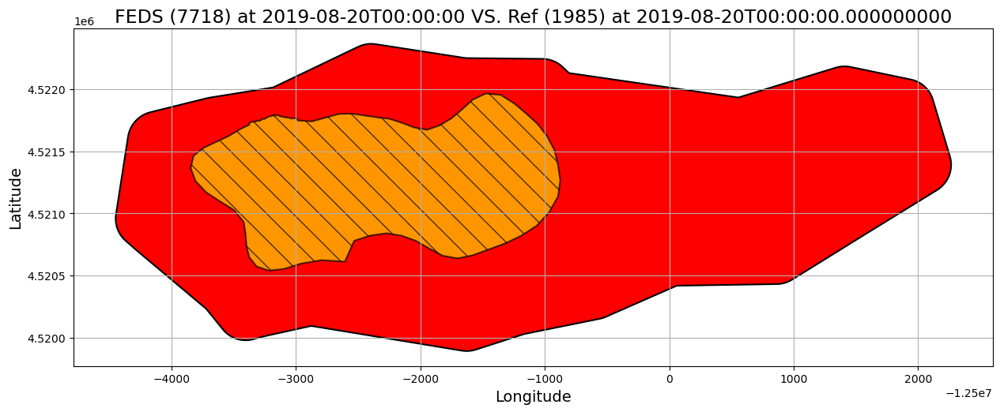

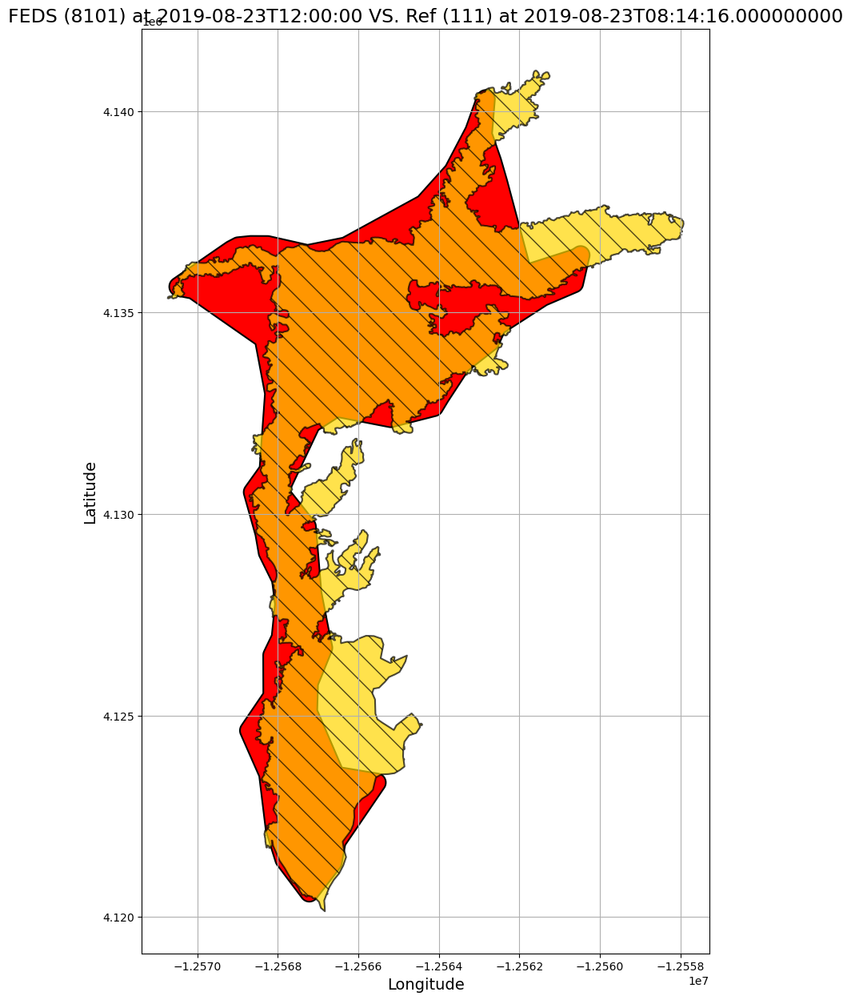

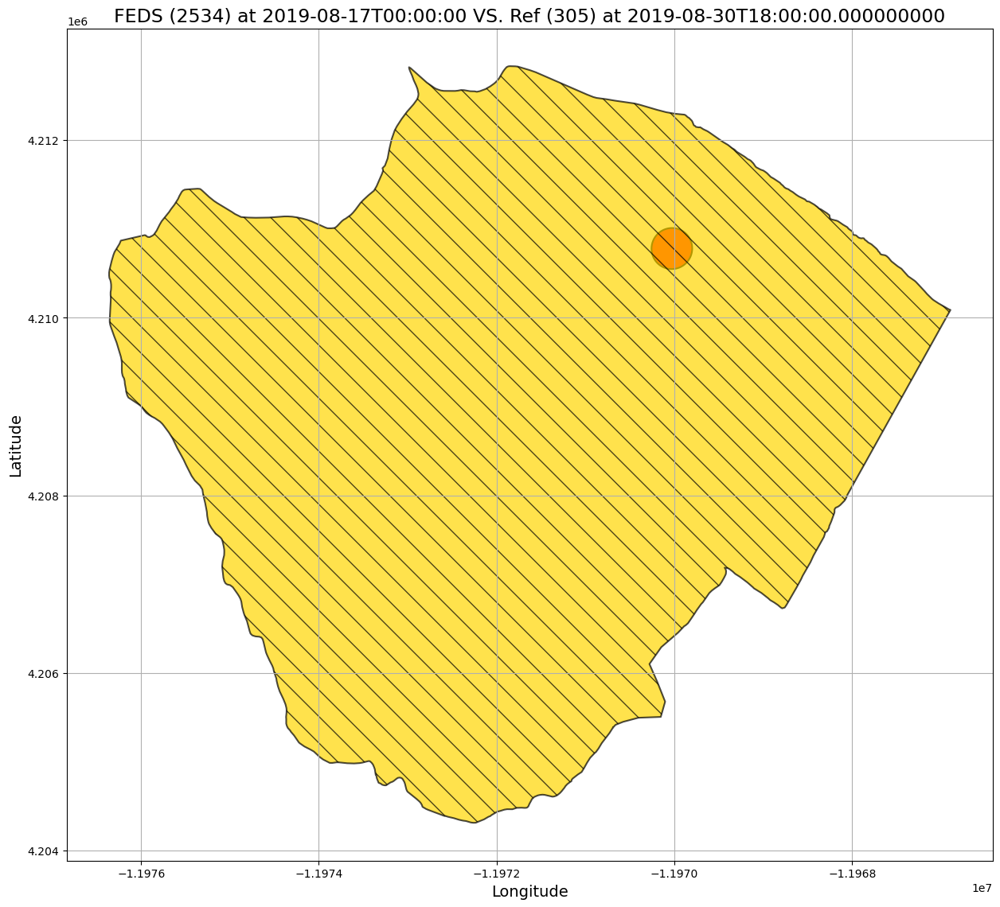

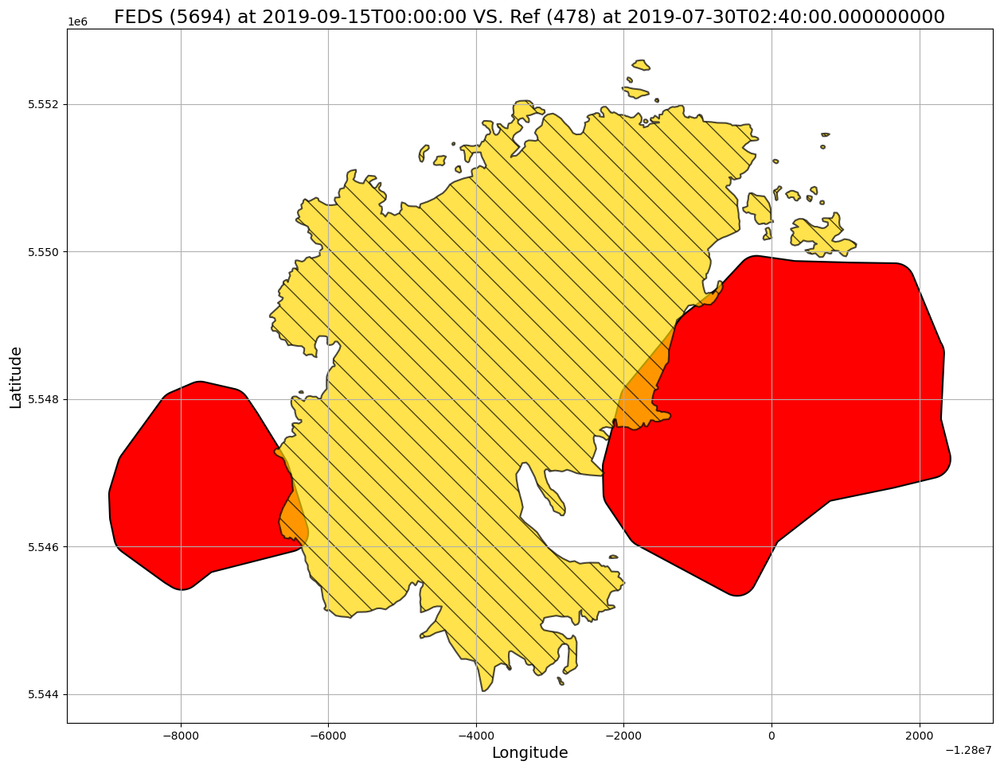

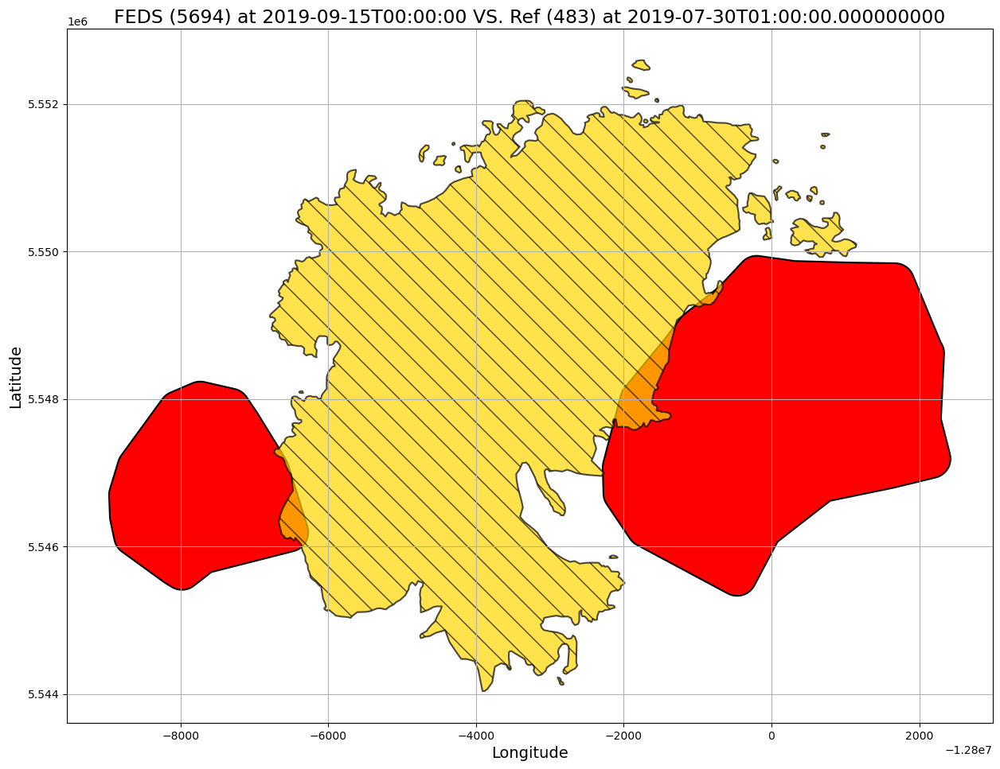

...

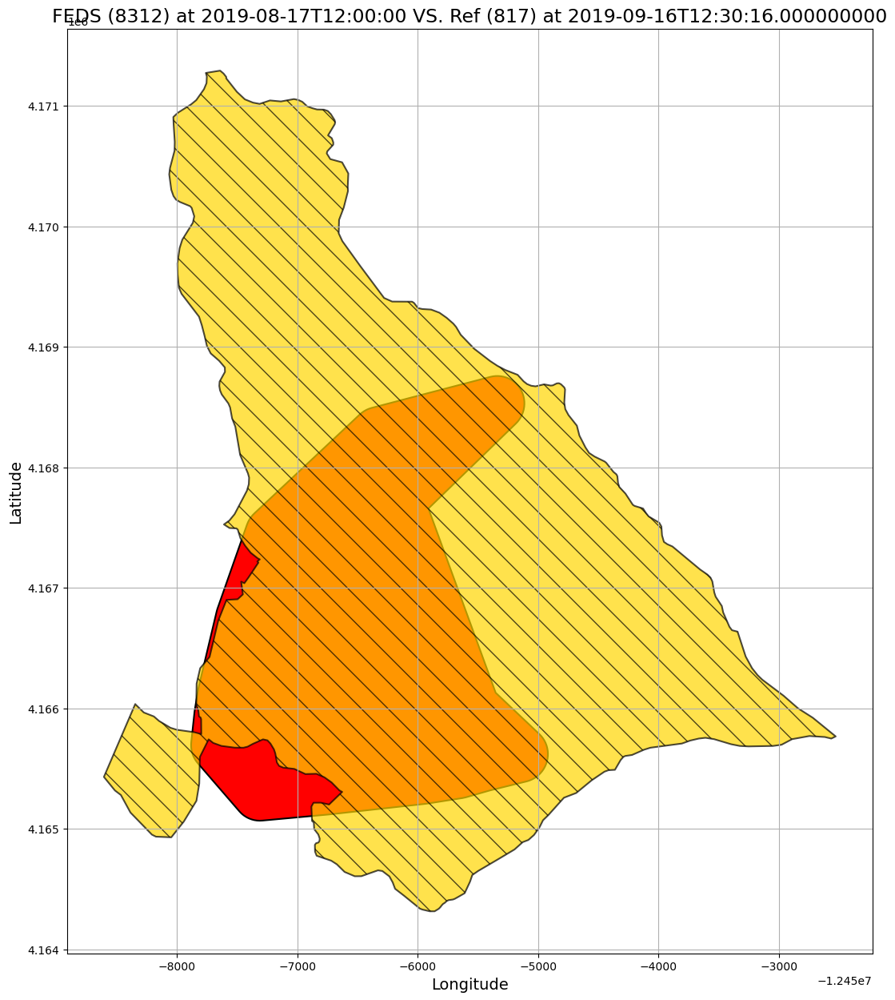

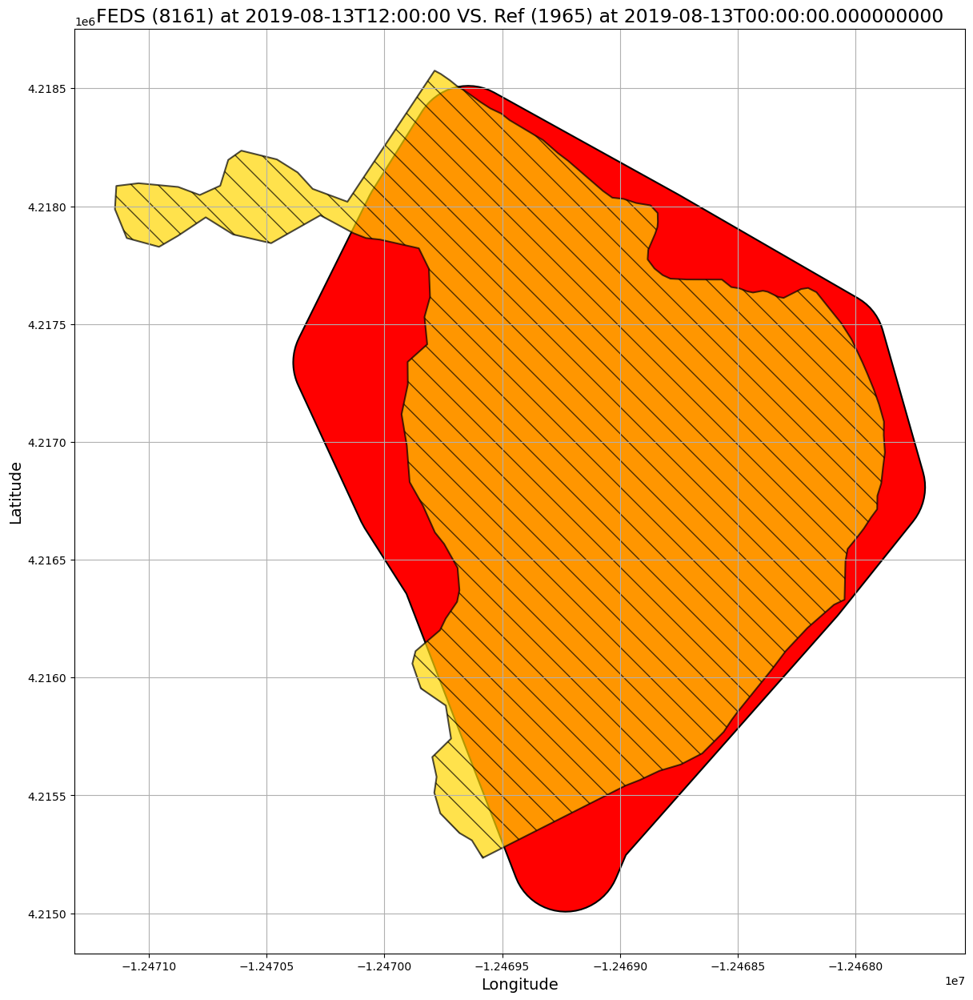

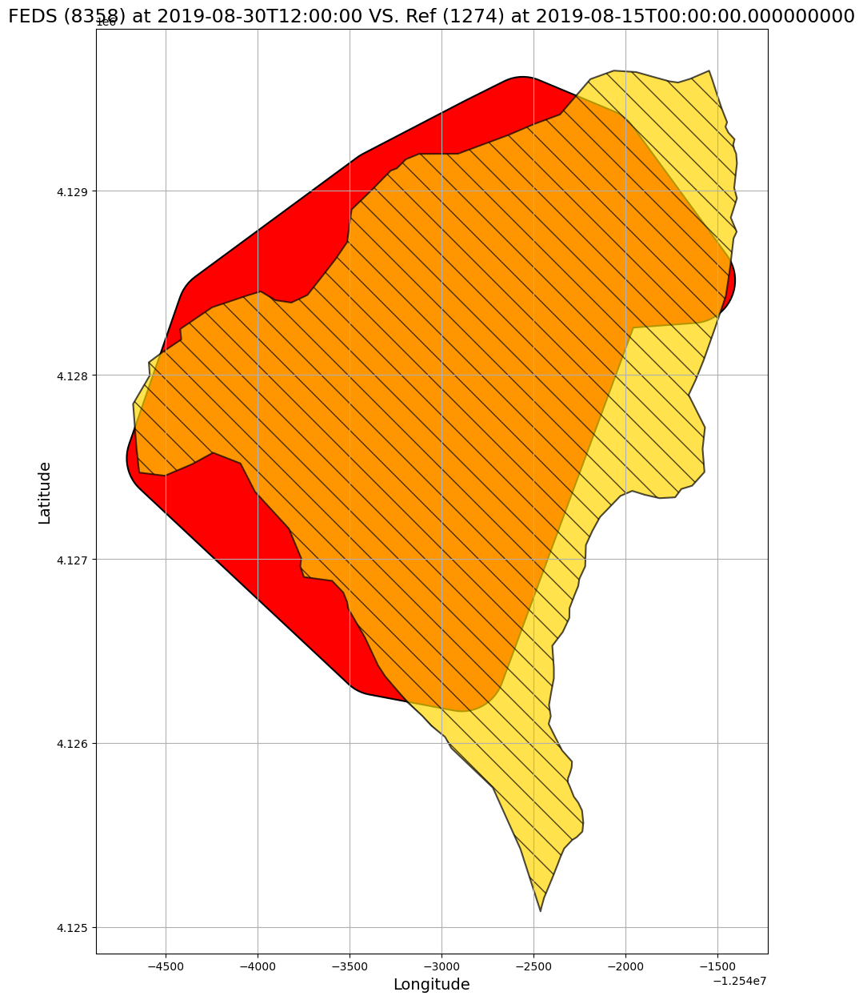

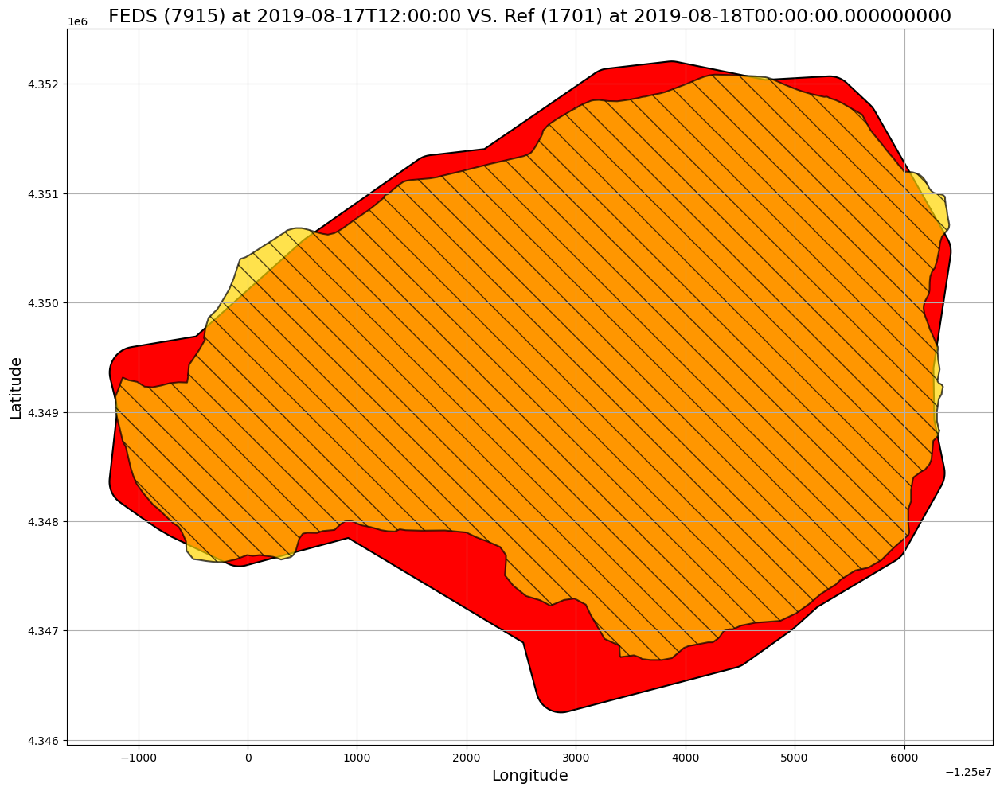

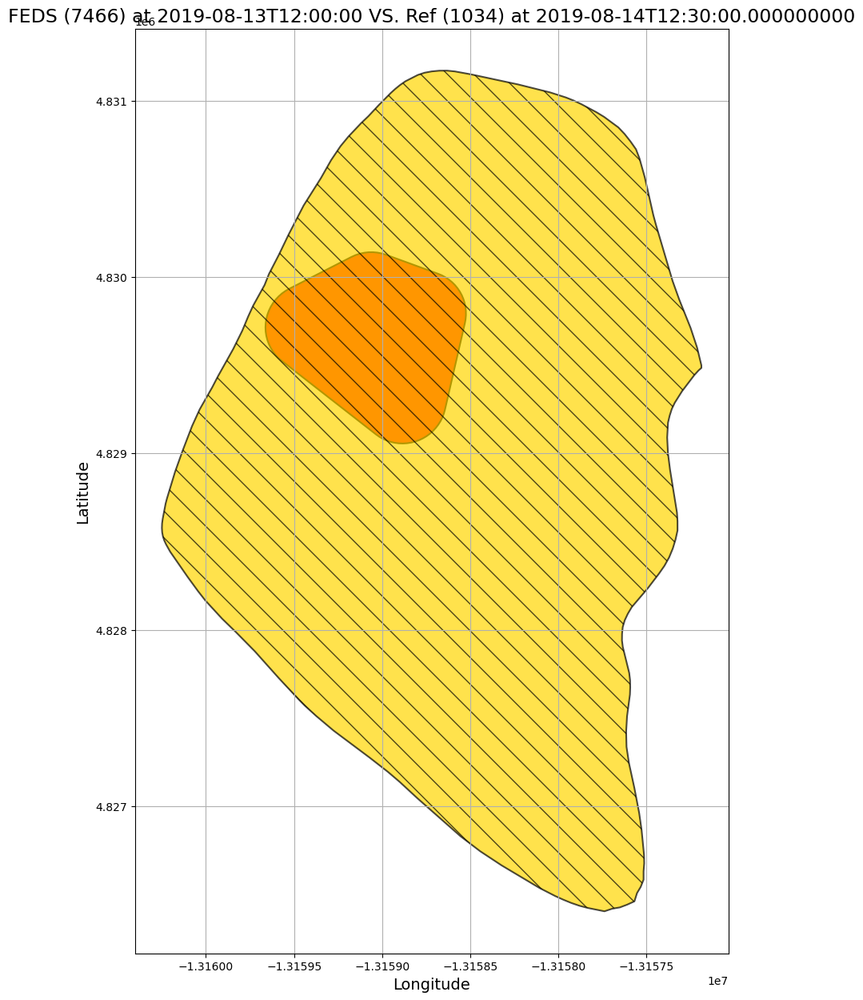

PLOTTING COMPLETE
VERBOSE: BOUNDS OF ALL FEDS SET: [-13729803.60930717   3721128.66453168 -11252290.85989269
   6319504.5666287 ]
VERBOSE: BOUNDS OF SINGE POLY:               minx          miny          maxx          maxy
7718 -1.250445e+07  4.519896e+06 -1.249774e+07  4.522368e+06
VERBOSE: NEW DIFF_AREA BOUNDS
-1421330.0787598814 1737504.2405576552 -1416067.5395889513 1739556.2228889193
VERBOSE: TIF BOUNDS
(-2362395.000000001, 221265.00000000373, 2327654.999999999, 3267405.0000000037)
VERBOSE: CALCULATION EXTRACTION
VERBOSE: BOUNDS OF ALL FEDS SET: [-13729803.60930717   3721128.66453168 -11252290.85989269
   6319504.5666287 ]
VERBOSE: BOUNDS OF SINGE POLY:               minx          miny          maxx          maxy
8101 -1.257071e+07  4.120387e+06 -1.256027e+07  4.140533e+06
VERBOSE: NEW DIFF_AREA BOUNDS
-1528207.8296598885 1426786.5951207958 -1517512.212253467 1442988.8660420817
VERBOSE: TIF BOUNDS
(-2362395.000000001, 221265.00000000373, 2327654.999999999, 3267405.0000000037)
VERBO

In [4]:
# create instances to track properties
print('You may see an ERROR 1 occur; ignore this unless block throws actual exception...')

feds_firenrt = InputFEDS(
                 feds_title, 
                 feds_collection, 
                 search_start,
                 search_stop,
                 search_bbox,
                 crs,
                 feds_access_type,
                 feds_limit,
                 feds_filter,
                 feds_apply_finalfire
                )

nifc_search = InputReference( 
                 search_start,
                 search_stop,
                 search_bbox,
                 crs,
                 ref_title,
                 ref_control_type,
                 ref_custom_url,
                 ref_custom_read_type,
                 ref_filter,
                )

my_output = OutputCalculation(
                feds_firenrt,
                nifc_search,
                output_format, 
                output_maap_url,
                day_search_range,
                print_on,
                plot_on
                )

### Tif Analysis on Symmetric Difference Matches (Exceeding Areas of FEDS over Reference)

This function built into the Output Class demonstrates research application uses of FEDS-PEC

Given the output matches, give a tif path, calculations of interest, and optional time (in days) limit. This will return associated TIF values for the symmetric difference of FEDS over the reference (FEDS - reference)

In [ ]:
# tif_path - replace with your own path
tif_path = "/projects/shared-buckets/gsfc_landslides/LANDFIRE/LF2022_FBFM40_220_CONUS/Tif/LC22_F40_220.tif" # "/projects/CONUS-Down/LF2020_SlpD_220_CONUS/Tif/LC20_SlpD_220.tif"
# array of values returned as get_res
get_res = my_output.tif_analysis(tif_path, "MEDIAN", 2)

### Export Polygons

Provide a path along with polygons, and then call on the `export_polygons` method for your OutputCalculation object

In [ ]:
# name your file
shp_file_name = "feds_used"
# resuses the same dir as the csv export 
output_shp_path = f"{user_path}/{shp_file_name}.shp"

my_output.export_polygons(feds_firenrt.polygons, output_shp_path)